# Overfit and underfit
## Train several models, use TensorBoard, use weight regularization and dropout

In [1]:
import tensorflow as tf

from tensorflow.keras import layers
from tensorflow.keras import regularizers

print(tf.__version__)

2.9.2


In [2]:
!pip install git+https://github.com/tensorflow/docs

import tensorflow_docs as tfdocs
import tensorflow_docs.modeling
import tensorflow_docs.plots

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/tensorflow/docs to /tmp/pip-req-build-xua6gy6z
  Running command git clone -q https://github.com/tensorflow/docs /tmp/pip-req-build-xua6gy6z
  Created wheel for tensorflow-docs: filename=tensorflow_docs-0.0.0.dev0-py3-none-any.whl size=184222 sha256=082c310b98d91f0fccf235852fb12cc1b3f240cf1a4ff77e909b9a938ac3682b
  Stored in directory: /tmp/pip-ephem-wheel-cache-40it55ck/wheels/cc/c4/d8/5341e93b6376c5c929c49469fce21155eb69cef1a4da4ce32c
Successfully built tensorflow-docs


In [3]:
from IPython import display
from matplotlib import pyplot as plt

import numpy as np

import pathlib
import shutil
import tempfile

In [4]:
logdir = "./tensorboard_logs/"
#logdir = pathlib.Path(tempfile.mkdtemp())/ "tensorboard_logs"
#shutil.rmtree(logdir, ignore_errors=True)

## Prepare data

In [5]:
# Higgs dataset: binary classification, 11.000.000 samples and 28 features
gz = tf.keras.utils.get_file('HIGGS.csv.gz', 'http://mlphysics.ics.uci.edu/data/higgs/HIGGS.csv.gz')

FEATURES = 28
ds = tf.data.experimental.CsvDataset(gz,[float(),]*(FEATURES+1), compression_type="GZIP")
# the tf.data.experimental.CsvDataset class can be used to read csv records directly from a gzip file with no intermediate decompression step.

# That csv reader class returns a list of scalars for each record. 
# This function repacks that list of scalars into a (feature_vector, label) pair.
def pack_row(*row):
  label = row[0]
  features = tf.stack(row[1:],1)
  return features, label

# TensorFlow is most efficient when operating on large batches of data. 
# So, instead of repacking each row individually make a new tf.data.Dataset 
# that takes batches of 10,000 examples, applies the pack_row function to each 
# batch, and then splits the batches back up into individual records
packed_ds = ds.batch(10000).map(pack_row).unbatch()

2816407858/2816407858 [==============================] - 122s 0us/step


In [6]:
# define data flow for the models
N_VALIDATION = int(1e3)
N_TRAIN = int(1e4)
BUFFER_SIZE = int(1e4)
BATCH_SIZE = 500
STEPS_PER_EPOCH = N_TRAIN//BATCH_SIZE

In [7]:
# split in train and validation (.cache() ensures that the loader doesn't need to re-read the data from the file on each epoch)
validate_ds = packed_ds.take(N_VALIDATION).cache()
train_ds = packed_ds.skip(N_VALIDATION).take(N_TRAIN).cache()

In [8]:
# these datasets return individual examples. Use the Dataset.batch method to create batches of an appropriate size for training. 
# Before batching, also remember to use Dataset.shuffle and Dataset.repeat on the training set.
validate_ds = validate_ds.batch(BATCH_SIZE)
train_ds = train_ds.shuffle(BUFFER_SIZE).repeat().batch(BATCH_SIZE)

## Training procedure

In [9]:
# use tf.keras.optimizers.schedules to reduce the learning rate over time:
lr_schedule = tf.keras.optimizers.schedules.InverseTimeDecay(
  0.001,
  decay_steps=STEPS_PER_EPOCH*1000,
  decay_rate=1,
  staircase=False)

def get_optimizer():
  return tf.keras.optimizers.Adam(lr_schedule)

In [10]:
# use the tfdocs.EpochDots which simply prints a . for each epoch, and a full set of metrics every 100 epochs.
# next include tf.keras.callbacks.EarlyStopping to avoid long and unnecessary training times.
# use callbacks.TensorBoard to generate TensorBoard logs for the training.
def get_callbacks(name):
  return [
    tfdocs.modeling.EpochDots(),
    tf.keras.callbacks.EarlyStopping(monitor = 'val_binary_crossentropy', patience = 100),
    tf.keras.callbacks.TensorBoard(logdir + name),
  ]

In [11]:
# each model will use the same Model.compile and Model.fit settings:
def compile_and_fit(model, name, optimizer=None, max_epochs=10000):
  if optimizer is None:
    optimizer = get_optimizer()
  model.compile(optimizer = optimizer,
                loss = tf.keras.losses.BinaryCrossentropy(from_logits=True),
                metrics = [tf.keras.losses.BinaryCrossentropy(from_logits=True, name='binary_crossentropy'), 'accuracy'])

  model.summary()

  history = model.fit(
    train_ds,
    steps_per_epoch = STEPS_PER_EPOCH,
    epochs = max_epochs,
    validation_data = validate_ds,
    callbacks = get_callbacks(name),
    verbose=0)
  return history

### Tiny model

In [12]:
tiny_model = tf.keras.Sequential([
    layers.Dense(32, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(1)
])

In [13]:
# istantiate empty dictionary to store history for all models
size_histories = {}

In [14]:
size_histories['Tiny'] = compile_and_fit(tiny_model, 'sizes/Tiny')

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32)                928       
                                                                 
 dense_1 (Dense)             (None, 1)                 33        
                                                                 
Total params: 961
Trainable params: 961
Non-trainable params: 0
_________________________________________________________________

Epoch: 0, accuracy:0.5057,  binary_crossentropy:0.7128,  loss:0.7128,  val_accuracy:0.5070,  val_binary_crossentropy:0.6902,  val_loss:0.6902,  
....................................................................................................
Epoch: 100, accuracy:0.6139,  binary_crossentropy:0.6173,  loss:0.6173,  val_accuracy:0.6110,  val_binary_crossentropy:0.6164,  val_loss:0.6164,  
............................................................

(0.5, 0.7)

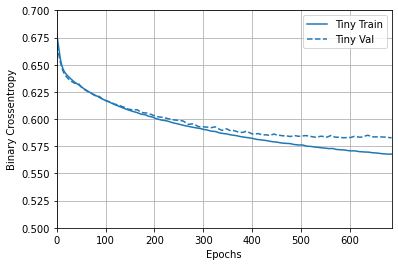

In [15]:
# plot history
plotter = tfdocs.plots.HistoryPlotter(metric = 'binary_crossentropy', smoothing_std=10)
plotter.plot(size_histories)
plt.ylim([0.5, 0.7])

### Small model

In [16]:
small_model = tf.keras.Sequential([
    layers.Dense(32, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(16, activation='elu'),
    layers.Dense(1)
])

In [17]:
size_histories['Small'] = compile_and_fit(small_model, 'sizes/Small')

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 32)                928       
                                                                 
 dense_3 (Dense)             (None, 16)                528       
                                                                 
 dense_4 (Dense)             (None, 1)                 17        
                                                                 
Total params: 1,473
Trainable params: 1,473
Non-trainable params: 0
_________________________________________________________________

Epoch: 0, accuracy:0.4839,  binary_crossentropy:0.7211,  loss:0.7211,  val_accuracy:0.4720,  val_binary_crossentropy:0.6965,  val_loss:0.6965,  
....................................................................................................
Epoch: 100, accuracy:0.6399,  binary_crossentropy:0.6027,  loss:0.602

### Medium model

In [18]:
medium_model = tf.keras.Sequential([
    layers.Dense(64, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(32, activation='elu'),
    layers.Dense(32, activation='elu'),
    layers.Dense(1)
])

In [19]:
size_histories['Medium']  = compile_and_fit(medium_model, "sizes/Medium")

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 64)                1856      
                                                                 
 dense_6 (Dense)             (None, 32)                2080      
                                                                 
 dense_7 (Dense)             (None, 32)                1056      
                                                                 
 dense_8 (Dense)             (None, 1)                 33        
                                                                 
Total params: 5,025
Trainable params: 5,025
Non-trainable params: 0
_________________________________________________________________

Epoch: 0, accuracy:0.4924,  binary_crossentropy:0.7347,  loss:0.7347,  val_accuracy:0.4680,  val_binary_crossentropy:0.7019,  val_loss:0.7019,  
......................................

### Large model

In [20]:
large_model = tf.keras.Sequential([
    layers.Dense(256, activation='elu', input_shape=(FEATURES,)),
    layers.Dense(128, activation='elu'),
    layers.Dense(128, activation='elu'),
    layers.Dense(64, activation='elu'),
    layers.Dense(1)
])

In [21]:
size_histories['large'] = compile_and_fit(large_model, "sizes/large")

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_9 (Dense)             (None, 256)               7424      
                                                                 
 dense_10 (Dense)            (None, 128)               32896     
                                                                 
 dense_11 (Dense)            (None, 128)               16512     
                                                                 
 dense_12 (Dense)            (None, 64)                8256      
                                                                 
 dense_13 (Dense)            (None, 1)                 65        
                                                                 
Total params: 65,153
Trainable params: 65,153
Non-trainable params: 0
_________________________________________________________________

Epoch: 0, accuracy:0.5049,  binary_crossentropy:0

### Plot train and validation histories

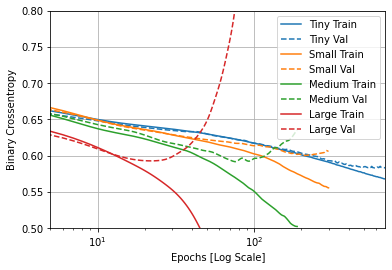

In [22]:
plotter.plot(size_histories)
a = plt.xscale('log')
plt.xlim([5, max(plt.xlim())])
plt.ylim([0.5, 0.8])
plt.xlabel("Epochs [Log Scale]")
plt.legend(loc=1, fontsize = 10)

### View in TensorBoard

In [23]:
# load the TensorBoard notebook extension
%load_ext tensorboard

# open an embedded TensorBoard viewer
%tensorboard --logdir {logdir}/sizes 

<IPython.core.display.Javascript object>

## Prevent overfitting with regularization

In [24]:
regularizer_histories = {}
regularizer_histories['Tiny'] = size_histories['Tiny']

### l2 regularization

In [25]:
l2_model = tf.keras.Sequential([
    layers.Dense(256, activation='elu', kernel_regularizer=regularizers.l2(0.001), input_shape=(FEATURES,)),
    layers.Dense(128, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(64, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(32, activation='elu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dense(1)
])

In [26]:
regularizer_histories['l2'] = compile_and_fit(l2_model, "regularizers/l2")

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_14 (Dense)            (None, 256)               7424      
                                                                 
 dense_15 (Dense)            (None, 128)               32896     
                                                                 
 dense_16 (Dense)            (None, 64)                8256      
                                                                 
 dense_17 (Dense)            (None, 32)                2080      
                                                                 
 dense_18 (Dense)            (None, 1)                 33        
                                                                 
Total params: 50,689
Trainable params: 50,689
Non-trainable params: 0
_________________________________________________________________

Epoch: 0, accuracy:0.5143,  binary_crossentropy:0

(0.5, 0.7)

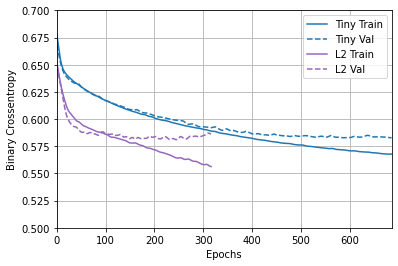

In [27]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

### dropout

In [28]:
dropout_model = tf.keras.Sequential([
    layers.Dense(256, activation='elu', input_shape=(FEATURES,)),
    layers.Dropout(0.5),
    layers.Dense(128, activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(64, activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(32, activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(1)
])

In [29]:
regularizer_histories['dropout'] = compile_and_fit(dropout_model, "regularizers/dropout")

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_19 (Dense)            (None, 256)               7424      
                                                                 
 dropout (Dropout)           (None, 256)               0         
                                                                 
 dense_20 (Dense)            (None, 128)               32896     
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_21 (Dense)            (None, 64)                8256      
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_22 (Dense)            (None, 32)               

(0.5, 0.7)

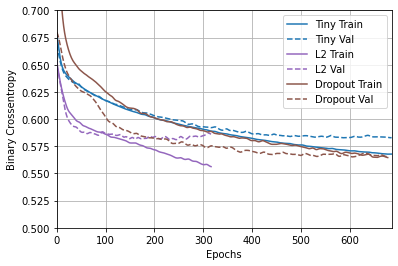

In [30]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

### l2 + dropout

In [31]:
combined_model = tf.keras.Sequential([
    layers.Dense(256, kernel_regularizer=regularizers.l2(0.0001), activation='elu', input_shape=(FEATURES,)),
    layers.Dropout(0.5),
    layers.Dense(128, kernel_regularizer=regularizers.l2(0.0001), activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(64, kernel_regularizer=regularizers.l2(0.0001), activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(32, kernel_regularizer=regularizers.l2(0.0001), activation='elu'),
    layers.Dropout(0.5),
    layers.Dense(1)
])

In [32]:
regularizer_histories['combined'] = compile_and_fit(combined_model, "regularizers/combined")

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_24 (Dense)            (None, 256)               7424      
                                                                 
 dropout_4 (Dropout)         (None, 256)               0         
                                                                 
 dense_25 (Dense)            (None, 128)               32896     
                                                                 
 dropout_5 (Dropout)         (None, 128)               0         
                                                                 
 dense_26 (Dense)            (None, 64)                8256      
                                                                 
 dropout_6 (Dropout)         (None, 64)                0         
                                                                 
 dense_27 (Dense)            (None, 32)               

(0.5, 0.7)

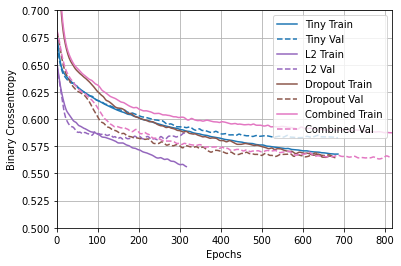

In [33]:
plotter.plot(regularizer_histories)
plt.ylim([0.5, 0.7])

### View in Tensorboard

In [ ]:
%tensorboard --logdir {logdir}/regularizers

<IPython.core.display.Javascript object>